<a href="https://colab.research.google.com/github/dataforgoodfr/batch7_satellite_ges/blob/master/notebooks/WIP_OCO2_Peaks_Wind.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
!apt-get install libgeos-3.5.0
!apt-get install libgeos-dev
!pip install https://github.com/matplotlib/basemap/archive/master.zip

In [0]:
from google.colab import drive
drive.mount('/content/drive')

# OCO2 - Reproduce F. Chevallier's figures

Project for **Data For Good**, season 7. 

*By Quentin Kamenda, Benoit Courty*


---

## Introduction

Using Data from [OCO-2 Satellite](en.wikipedia.org/wiki/Orbiting_Carbon_Observatory_2), issued by the NASA.

We here try to reproduce the results from [this paper](https://www.atmos-chem-phys-discuss.net/acp-2020-123/) by F. Chevallier, trying to "[observe] carbon dioxide emissions over China's cities with the Orbiting Carbon Observatory-2".

`//TODO: Explanation`

In [0]:
import pandas as pd
import numpy as np
from numpy import exp, loadtxt, pi, sqrt
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.basemap import Basemap  #Imported directly from the github repository

## Show Data on the map

##### **draw_map**: Function to draw the map and the observations (relief style). The column names can be specified in the arguments.

*Parameters*: 

*   (DataFrame) data: the dataset to map.
*   (string) **x** : the name of the longitude column. *default: 'longitide'*
*   (string) **y**: the name of the latitude column. *default: 'latitude'*
*   (string) **c**: the name of the XCO2 column (or other measure wanted to be plotted). *default: 'xco2'*
*   (int) **lon_min** : the minimum longitude. *default: -180*
*   (int) **lon_max**: the maximum longitude. *default: 180*
*   (int) **lat_min**: the minimum latitude. *default: -90*
*   (int) **lat_max**: the maximum latitude. *default: 90*
*   (int) **size_point**: size of the point to plot (useful if we zoom in). *default: 1*
*   (Bool) **frontier**: whether or not to draw the countries borders. *default: False*



In [0]:
def draw_map(data, x="longitude", y="latitude", c="xco2", lon_min=-180, lon_max=180, lat_min=-90, lat_max=90, size_point=1, frontier=False):

    plt.figure(figsize=(15, 10), edgecolor='w')
    m = Basemap(llcrnrlat=lat_min, urcrnrlat=lat_max, llcrnrlon=lon_min, urcrnrlon=lon_max)
    
    m.shadedrelief()
    
    parallels = np.arange(-80.,81,10.)
    m.drawparallels(parallels,labels=[False,True,True,False])

    meridians = np.arange(10.,351.,20.)
    m.drawmeridians(meridians,labels=[True,False,False,True])

    normal = matplotlib.colors.LogNorm(vmin=data[c].min(), vmax=data[c].max())

    m.scatter(data[x], data[y], c=data[c], cmap=plt.cm.jet, s=size_point, norm=normal)

    if (frontier):
      m.drawcountries(linewidth=0.5)
      m.drawcoastlines(linewidth=0.7)

    plt.show()

##### **haversine**: Function to calculate the great circle distance between two points on the earth given longitude and latitude.

*Parameters*: 

*   (int) **lon1** : the longitude of the first point.
*   (int) **lon2**: the latitude of the first point.
*   (int) **lat1**: the longitude of the second point.
*   (int) **lat2**: the latitude of the second point.

*Return:*


*   (int) the distance (in kilometers)

In [0]:
from math import radians, cos, sin, asin, sqrt

def haversine_formula(lon1, lat1, lon2, lat2):
    # convert decimal degrees to radians 
    lon1, lat1, lon2, lat2 = map(radians, [lon1, lat1, lon2, lat2])

    # haversine formula 
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a)) 
    r = 6371 # Radius of earth in kilometers. Use 3956 for miles
    return c * r

def haversine(row, lat, lon):
    return haversine_formula(lon, lat, row['longitude'], row['latitude'])

---

## Retieve Data

Sample data can be accessed freely on the NASA Database, among other open data from several NASA sattelites.

We will be using a CSV of peaks detected by *Benoit Courty* [here](https://http://courty.fr/OCO2/).

In [0]:
data = pd.read_csv("https://courty.fr/OCO2/result_doco2_1808-o22158.csv", sep=",", index_col=0)

data.head()

,sounding_id,latitude,longitude,orbit,slope,intercept,amplitude,sigma,delta,R,windspeed_u,windspeed_v
0,2018080101035604,25.425072,-177.345490,21709,-0.000017,404.786068,-9.322890,-3.818291,0.974073,0.660388,-7.759225,-0.739198
1,2018080101050203,29.112371,-178.352524,21709,-0.001326,405.023519,2.480614,2.097535,0.471802,0.651822,-6.748729,-1.210935
2,2018080101062177,33.494995,-179.648438,21709,-0.002496,404.507099,6.427538,2.924886,0.876690,0.698739,-4.581494,-0.911555
3,2018080102464472,38.513145,153.990067,21710,-0.002990,404.778809,-8.891458,-2.091188,1.696251,0.686102,-3.375677,8.726022
4,2018080102564438,69.815544,131.086807,21710,-0.008529,399.893348,6.977613,2.478258,1.123234,0.517606,-3.290220,-0.373389


In [0]:
data.describe()

,sounding_id,latitude,longitude,orbit,slope,intercept,amplitude,sigma,delta,R,windspeed_u,windspeed_v
count,2.313000e+03,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000
mean,2.018082e+15,20.868098,-2.349540,21946.058366,-0.002569,404.189876,18.745080,14.348495,0.536493,0.588711,-1.249908,-0.063434
std,9.199090e+08,25.944414,107.720979,134.152974,0.009088,1.985969,23.779654,12.464226,0.434811,0.076865,4.430765,3.591642
min,2.018080e+15,-36.018448,-179.648438,21709.000000,-0.070105,398.965334,-122.489640,-33.132299,0.003814,0.500004,-9.020993,-13.380523
25%,2.018081e+15,-2.046461,-112.551079,21814.000000,-0.004114,402.884122,4.937479,7.606247,0.233205,0.529653,-4.993138,-2.770149
50%,2.018082e+15,30.276360,15.994817,21963.000000,-0.002153,404.599571,13.087726,15.043082,0.439802,0.564811,-2.178347,-0.072568
75%,2.018083e+15,39.875168,81.461533,22061.000000,0.001393,405.883681,26.872900,23.688184,0.716917,0.629732,2.718249,2.928468
max,2.018083e+15,72.814903,179.976379,22158.000000,0.017307,408.109593,221.239819,33.288264,3.943475,0.924756,13.018653,11.974917


We spot some negative sigma and amplitude parameters.

In [0]:
data['sigma'] = data['sigma'].apply(abs)
data['amplitude'] = data['amplitude'].apply(abs)
data.head(15)

,sounding_id,latitude,longitude,orbit,slope,intercept,amplitude,sigma,delta,R,windspeed_u,windspeed_v
0,2018080101035604,25.425072,-177.345490,21709,-0.000017,404.786068,9.322890,3.818291,0.974073,0.660388,-7.759225,-0.739198
1,2018080101050203,29.112371,-178.352524,21709,-0.001326,405.023519,2.480614,2.097535,0.471802,0.651822,-6.748729,-1.210935
2,2018080101062177,33.494995,-179.648438,21709,-0.002496,404.507099,6.427538,2.924886,0.876690,0.698739,-4.581494,-0.911555
3,2018080102464472,38.513145,153.990067,21710,-0.002990,404.778809,8.891458,2.091188,1.696251,0.686102,-3.375677,8.726022
4,2018080102564438,69.815544,131.086807,21710,-0.008529,399.893348,6.977613,2.478258,1.123234,0.517606,-3.290220,-0.373389
5,2018080104220301,26.624556,132.902069,21711,-0.002916,406.237532,69.440162,22.553555,1.228304,0.602475,3.076021,5.960368
6,2018080104241836,34.093071,130.723083,21711,-0.001673,405.832664,7.668979,3.101237,0.986535,0.564589,-4.438503,-0.151730
7,2018080104243337,34.913078,130.466461,21711,-0.003367,405.669386,8.073160,3.172612,1.015165,0.712848,-2.819998,-2.047116
8,2018080104244906,35.789249,130.185776,21711,-0.004689,405.292668,8.141250,8.207207,0.395736,0.515282,-2.545387,-1.840344
9,2018080104245535,36.149014,130.068329,21711,-0.004583,405.161842,2.956341,12.244524,0.096321,0.662136,-2.414776,-1.631612


In [0]:
data.describe()

,sounding_id,latitude,longitude,orbit,slope,intercept,amplitude,sigma,delta,R,windspeed_u,windspeed_v
count,2.313000e+03,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000
mean,2.018082e+15,20.868098,-2.349540,21946.058366,-0.002569,404.189876,20.951823,16.640968,0.536493,0.588711,-1.249908,-0.063434
std,9.199090e+08,25.944414,107.720979,134.152974,0.009088,1.985969,21.859396,9.180615,0.434811,0.076865,4.430765,3.591642
min,2.018080e+15,-36.018448,-179.648438,21709.000000,-0.070105,398.965334,0.100808,2.000477,0.003814,0.500004,-9.020993,-13.380523
25%,2.018081e+15,-2.046461,-112.551079,21814.000000,-0.004114,402.884122,6.402464,8.815902,0.233205,0.529653,-4.993138,-2.770149
50%,2.018082e+15,30.276360,15.994817,21963.000000,-0.002153,404.599571,14.047673,16.074852,0.439802,0.564811,-2.178347,-0.072568
75%,2.018083e+15,39.875168,81.461533,22061.000000,0.001393,405.883681,27.590997,24.291017,0.716917,0.629732,2.718249,2.928468
max,2.018083e+15,72.814903,179.976379,22158.000000,0.017307,408.109593,221.239819,33.288264,3.943475,0.924756,13.018653,11.974917


To convert the  ``` sounding_id ``` into a datetime variable ```data```:



In [0]:
from datetime import datetime
def to_date(a):
    return datetime.strptime(str(a), '%Y%m%d%H%M%S%f')

data['date'] = data['sounding_id'].apply(to_date)
data.head()

,sounding_id,latitude,longitude,orbit,slope,intercept,amplitude,sigma,delta,R,windspeed_u,windspeed_v,date
0,2018080101035604,25.425072,-177.345490,21709,-0.000017,404.786068,9.322890,3.818291,0.974073,0.660388,-7.759225,-0.739198,2018-08-01 01:03:56.040
1,2018080101050203,29.112371,-178.352524,21709,-0.001326,405.023519,2.480614,2.097535,0.471802,0.651822,-6.748729,-1.210935,2018-08-01 01:05:02.030
2,2018080101062177,33.494995,-179.648438,21709,-0.002496,404.507099,6.427538,2.924886,0.876690,0.698739,-4.581494,-0.911555,2018-08-01 01:06:21.770
3,2018080102464472,38.513145,153.990067,21710,-0.002990,404.778809,8.891458,2.091188,1.696251,0.686102,-3.375677,8.726022,2018-08-01 02:46:44.720
4,2018080102564438,69.815544,131.086807,21710,-0.008529,399.893348,6.977613,2.478258,1.123234,0.517606,-3.290220,-0.373389,2018-08-01 02:56:44.380


---

## Plot Peaks

### Simple plot (Gaussian)

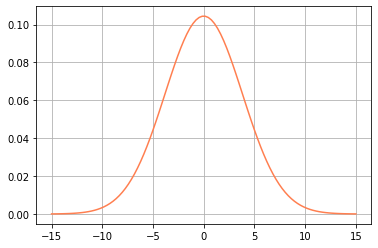

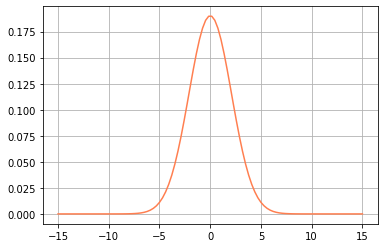

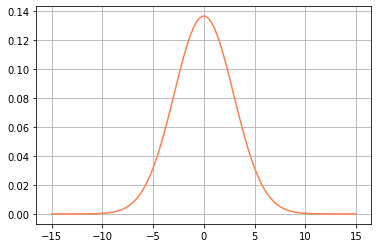

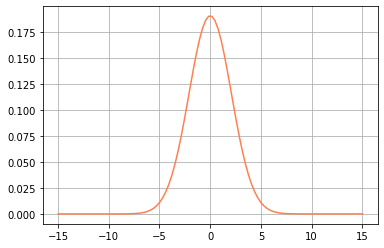

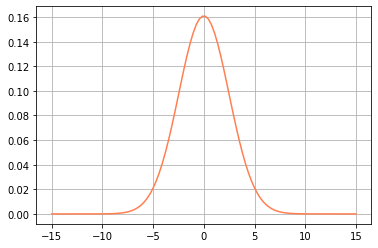

In [0]:
import scipy.stats as stats

df = data[:5]

for sigma in df['sigma'][:5]:

    std = abs(sigma)

    x = np.linspace(-15, 15, 100)
    y = stats.norm.pdf(x,0,std)

    plt.plot(x,y, color='coral')

    plt.grid()

    plt.show()

### Map plot

In [0]:
from plotly.figure_factory import create_quiver
import plotly.graph_objects as go
import plotly.express as px

fig = px.scatter_mapbox(data, lat="latitude", lon="longitude", 
                        hover_name="date", hover_data=["amplitude", "sigma"],
                        color_discrete_sequence=["red"], zoom=2, height=700)

fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig.show()
fig.write_html("./peaks.html")

### Map plot (Folium)

In [0]:
import folium

folium_map = folium.Map([43, -100], zoom_start=4,tiles="CartoDB dark_matter")

for index, row in df_res.iterrows():
    radius = row["amplitude"]/20
    color="#E37222" # tangerine
    tooltip =  "["+str(round(row['latitude'],2))+" ; "+str(round(row['longitude'],2))+"]"
    
    folium.CircleMarker(location=(row["latitude"],
                                  row["longitude"]),
                        radius=radius,
                        color=color,
                        tooltip=tooltip,
                        fill=True).add_to(folium_map)

folium_map

### Map Plot woth Scatter Plots (INCOMPLETE)

In [0]:
!pip install geopandas

In [0]:
import os
import glob
import numpy as np
import pandas as pd

input_dir = 'http://courty.fr/OCO2/'

In [0]:
# http://courty.fr/OCO2/peak_data-f_oco2_1808-o_21733-si_2018080216413233.json

def load_one_peak_data(sounding_id, df_all_peak):
    df_param = df_all_peak.query("sounding_id==@sounding_id")
    param_index = df_param.index[0]
    url = input_dir + "peak_data-f_oco2_1808-o_"+str(df_param.loc[param_index, 'orbit'])+"-si_"+sounding_id+".json"
    print(url)
    df_peak = pd.read_json(url)
    
    gaussian_param = {
        'slope' : df_param.loc[param_index, 'slope'],
        'intercept' : df_param.loc[param_index, 'intercept'],
        'amplitude' : df_param.loc[param_index, 'amplitude'],
        'sigma': df_param.loc[param_index, 'sigma'],
        'delta': df_param.loc[param_index, 'delta'],
        'R' : df_param.loc[param_index, 'R'],
    }
    return df_peak, gaussian_param

'''
x : the data input value
m : the slope of the data
b : the intercep of the data
A : Amplitude de la courbe
sig : sigma / écart type de la courbe
'''
def gaussian(x, m, b, A, sig):
    return m * x + b + A / (sig * (2 * np.pi)**0.5) * np.exp(-x**2 / (2*sig**2))

def plot_peak(df_peak, gaussian_param):
    x = df_peak['distance']
    y = df_peak['xco2']
    y = y - gaussian_param['slope'] * x - gaussian_param['intercept']
    plt.scatter(x, y, c=y, s=3, label='sounding')
    plt.plot(x, gaussian(x, m=0, b=0, A=gaussian_param['amplitude'], sig=gaussian_param['sigma']), 'r', label='fit')
    plt.legend()
    plt.title('OCO 2 data')
    plt.xlabel('Distance')
    plt.ylabel('CO²')
    plt.show()

http://courty.fr/OCO2/peak_data-f_oco2_1808-o_22159-si_2018083122324108.json
{'slope': 0.004776745630485172, 'intercept': 406.0322138728357, 'amplitude': 7.993881983969049, 'sigma': 20.035509511802843, 'delta': 0.15917226891913366, 'R': 0.5012533577553441}


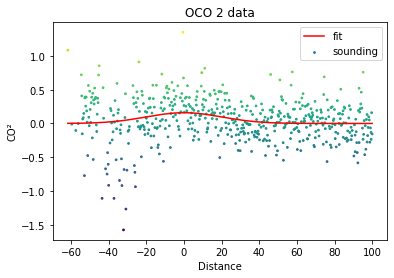

In [0]:
df_res = pd.read_csv(input_dir + "result_for_oco2_1808.csv", sep=",")
df_peak, gaussian_param = load_one_peak_data("2018083122324108", df_res)
print(gaussian_param)
plot_peak(df_peak, gaussian_param)

In [0]:
import folium

folium_map = folium.Map([43, -100], zoom_start=4,tiles="CartoDB dark_matter")

for index, row in df_res.iterrows():
    radius = row["amplitude"]/20
    color="#E37222" # tangerine
    tooltip =  "["+str(round(row['latitude'],2))+" ; "+str(round(row['longitude'],2))+"]"
    # popup = folium.Popup(max_width=450).add_child(folium.Vega(peak, width=450, height=250))

    # url = input_dir + "peak_data-f_oco2_1808-o_"+str(int(row['orbit']))+"-si_"+str(int(row['sounding_id']))+".json"
    # print(url)
    # peak = pd.read_json(url)
    
    folium.CircleMarker(location=(row["latitude"],
                                  row["longitude"]),
                        radius=radius,
                        color=color,
                        tooltip=tooltip,
                        # popup=popup,
                        fill=True).add_to(folium_map)

folium_map

### Map plot with wind vectors (INCOMPLETE)

In [0]:
# Create quiver figure
fig = create_quiver(data.longitude, data.latitude, data.windspeed_u, data.windspeed_v,
                       scale=.25,
                       arrow_scale=.4,
                       name='quiver',
                       line_width=1)

fig.add_trace(go.Scatter(x=data.longitude, y=data.latitude,
                    mode='markers',
                    marker_size=2,
                    name='points'))


fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig.show()
fig.write_html("./winds.html")

### Map Plot with EDGAR sources (INCOMPLETE - Too much data)

In [0]:
path_Edgar_2018 = "/content/drive/My Drive/Data For Good - S7: Ministère & O-CO2/data/edgar/CO2_emissions_Edgar_2018_v3.csv"

edgar = pd.read_csv(path_Edgar_2018, sep=",", index_col=0)

edgar.head()

/usr/local/lib/python3.6/dist-packages/numpy/lib/arraysetops.py:569: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



,latitude,longitude,CO2 emissions,CO2 classification,CO2 classification encoded
0,-89.949997,0.050000,0.0,Low,0
1,-78.349998,-147.949997,0.0,Low,0
2,-78.449997,-147.949997,0.0,Low,0
3,-78.550003,-147.949997,0.0,Low,0
4,-78.650002,-147.949997,0.0,Low,0


In [0]:
# We only keep the 75% highest registered emitters
edgar_top = edgar[edgar['CO2 classification encoded'] > 2]
edgar_top.describe()

edgar_top['CO2 classification encoded'][round(0.95*dataframe_list_v1.shape[0]):] = 'Very high'

,latitude,longitude,CO2 emissions,CO2 classification encoded
count,324000.000000,324000.000000,3.240000e+05,324000.0
mean,31.408045,10.237668,3.633424e-08,3.0
std,22.213159,83.376957,4.110545e-07,0.0
min,-77.849998,-179.949997,2.126474e-09,3.0
25%,24.450001,-79.049988,3.597865e-09,3.0
50%,36.750000,19.750000,6.291224e-09,3.0
75%,45.849998,82.150002,1.361606e-08,3.0
max,80.050003,179.949997,1.208277e-04,3.0


In [0]:
folium_map = folium.Map([43, -100], zoom_start=4,tiles="CartoDB dark_matter")

for index, row in df_res.iterrows():
    radius = row["amplitude"]/20
    color="#E37222" # tangerine
    tooltip =  "["+str(round(row['latitude'],2))+" ; "+str(round(row['longitude'],2))+"]"
    # popup = folium.Popup(max_width=450).add_child(folium.Vega(peak, width=450, height=250))

    # url = input_dir + "peak_data-f_oco2_1808-o_"+str(int(row['orbit']))+"-si_"+str(int(row['sounding_id']))+".json"
    # print(url)
    # peak = pd.read_json(url)
    
    folium.CircleMarker(location=(row["latitude"],
                                  row["longitude"]),
                        radius=radius,
                        color=color,
                        tooltip=tooltip,
                        # popup=popup,
                        fill=True).add_to(folium_map)
    
for index, row in edgar_top.iterrows():
    radius = 1
    color="#3186CC" # blue
    tooltip =  "["+str(round(row['latitude'],2))+" ; "+str(round(row['longitude'],2))+"]"
    
    folium.CircleMarker(location=(row["latitude"],
                                  row["longitude"]),
                        radius=radius,
                        color=color,
                        tooltip=tooltip,
                        fill=True).add_to(folium_map)

folium_map

### Map plot with Centrale sources

In [0]:
path_plants = "https://raw.githubusercontent.com/dataforgoodfr/batch7_satellite_ges/master/dataset/CO2_emissions_centrale.csv"

plants = pd.read_csv(path_plants, sep=",", index_col=0)

plants.head()

,country_long,capacity_mw,latitude,longitude,primary_fuel,generation_gwh_2013,generation_gwh_2014,generation_gwh_2015,generation_gwh_2016,generation_gwh_2017,estimated_generation_gwh,gCO2/KWh,generation_gwh_2017_with_estimated_data,tCO2_emitted_in_2013,tCO2_emitted_in_2014,tCO2_emitted_in_2015,tCO2_emitted_in_2016,tCO2_emitted_in_2017,tCO2_emitted_in_2017_with estimated_data
0,Afghanistan,42.0,34.5638,69.1134,Gas,NaN,NaN,NaN,NaN,NaN,NaN,443,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Algeria,520.0,35.8665,6.0262,Gas,NaN,NaN,NaN,NaN,NaN,2152.249819,443,2152.249819,NaN,NaN,NaN,NaN,NaN,9.534467e+05
2,Algeria,71.0,36.8924,7.7634,Gas,NaN,NaN,NaN,NaN,NaN,293.864879,443,293.864879,NaN,NaN,NaN,NaN,NaN,1.301821e+05
3,Algeria,560.0,36.5988,3.1375,Gas,NaN,NaN,NaN,NaN,NaN,2317.807497,443,2317.807497,NaN,NaN,NaN,NaN,NaN,1.026789e+06
4,Algeria,100.0,36.5914,2.9223,Gas,NaN,NaN,NaN,NaN,NaN,413.894196,443,413.894196,NaN,NaN,NaN,NaN,NaN,1.833551e+05


In [0]:
plants.describe()

,capacity_mw,latitude,longitude,generation_gwh_2013,generation_gwh_2014,generation_gwh_2015,generation_gwh_2016,generation_gwh_2017,estimated_generation_gwh,gCO2/KWh,generation_gwh_2017_with_estimated_data,tCO2_emitted_in_2013,tCO2_emitted_in_2014,tCO2_emitted_in_2015,tCO2_emitted_in_2016,tCO2_emitted_in_2017,tCO2_emitted_in_2017_with estimated_data
count,8602.000000,8602.000000,8602.000000,3078.000000,3117.000000,3312.000000,3274.000000,3210.000000,5403.000000,8602.000000,8440.000000,3.078000e+03,3.117000e+03,3.312000e+03,3.274000e+03,3.210000e+03,8.440000e+03
mean,434.151369,27.287221,-5.885974,1045.620597,1091.104519,1120.312133,1058.376820,1134.772571,2265.492359,700.833062,1842.772024,8.687061e+05,9.019768e+05,9.131356e+05,8.718276e+05,9.289991e+05,1.538757e+06
std,690.388169,24.641181,86.714480,2578.122419,2715.041407,2675.889462,2632.241272,2674.701678,7140.625909,256.469725,5953.860708,2.528086e+06,2.625053e+06,2.607140e+06,2.559000e+06,2.588440e+06,6.046563e+06
min,1.000000,-77.847000,-179.977700,-2.653000,-262.902000,-141.014000,-127.507000,-132.033000,0.000000,443.000000,-132.033000,-1.845416e+03,-2.045378e+05,-6.246920e+04,-5.648560e+04,-5.849062e+04,-5.849062e+04
25%,16.073750,21.434975,-84.425525,0.035250,0.032000,0.025000,0.019000,0.341514,89.494709,443.000000,18.882956,2.567400e+01,2.134832e+01,1.711600e+01,1.287562e+01,2.172565e+02,1.086195e+04
50%,132.250000,35.594300,-23.547500,18.245000,16.227000,22.749000,16.377500,36.623000,737.318085,778.000000,340.484944,8.859949e+03,8.021180e+03,1.098873e+04,8.077698e+03,1.881502e+04,2.080822e+05
75%,600.000000,42.104150,79.832125,633.405479,630.858000,762.341497,583.308501,697.294500,2782.119122,1050.000000,2240.154958,3.416080e+05,3.368590e+05,4.247199e+05,3.279560e+05,3.801258e+05,1.423369e+06
max,8865.000000,71.292000,178.835900,27586.200000,28127.000000,32157.000000,30015.000000,35116.000000,450562.692350,1050.000000,450562.692350,2.896551e+07,2.953335e+07,3.376485e+07,3.151575e+07,3.687180e+07,4.730908e+08


In [0]:
peaks_and_plants_dark = folium.Map([43, 0], zoom_start=4,tiles="CartoDB dark_matter")

for index, row in plants.iterrows():
    radius = 0.1
    color="#3186CC" # blue
    tooltip =  "["+str(round(row['latitude'],2))+" ; "+str(round(row['longitude'],2))+"]"
    emit = str(round(row['estimated_generation_gwh'],2))
    popup_html="""<h4>"""+tooltip+"""</h4>"""+row['country_long']+"""<p>Emission 2018 (est): """+emit+""" GWh</p>"""

    popup=folium.Popup(popup_html, max_width=450)

    folium.CircleMarker(location=(row["latitude"],
                                  row["longitude"]),
                        radius=radius,
                        color=color,
                        tooltip=tooltip,
                        popup=popup,
                        fill=True).add_to(peaks_and_plants_dark)

for index, row in data.iterrows():
    radius = row["amplitude"]/20
    color="#E37222" # tangerine
    tooltip =  "["+str(round(row['latitude'],2))+" ; "+str(round(row['longitude'],2))+"]"
    sounding = str(row['sounding_id'])
    date = str(row['date'])
    orbit = str(row['orbit'])
    
    popup_html="""<h4>"""+tooltip+"""</h4>"""+date+"""<p>sounding_id: """+sounding+"""</br>orbit: """+orbit+"""</p>"""

    popup=folium.Popup(popup_html, max_width=450)
    
    folium.CircleMarker(location=(row["latitude"],
                                  row["longitude"]),
                        radius=radius,
                        color=color,
                        tooltip=tooltip,
                        popup=popup,
                        fill=True).add_to(peaks_and_plants_dark)

peaks_and_plants_dark

In [0]:
peaks_and_plants.save('peaks_and_plants.html')